In [1]:
import urllib.request, urllib.parse, urllib.error
import json
import pandas as pd
import numpy
import ssl
import plotly
from plotly.offline import init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [2]:
import plotly.graph_objs as go
import plotly.express as px

# World Dataset

In [3]:
df_world=pd.read_csv('Datasets/covid_19_data.csv')

In [4]:
df_world.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


In [5]:
df_world=df_world.rename(columns={'Country/Region':'Country'})
df_world=df_world.rename(columns={'ObservationDate':'Date'})
df_world=df_world.rename(columns={'Province/State':'State'})

In [6]:
df_world.head()

,SNo,Date,State,Country,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


In [7]:
df_countries=df_world.groupby(['Country','Date']).sum().reset_index().sort_values('Date', ascending=False)
df_countries=df_countries.drop_duplicates(subset=['Country'])
df_countries=df_countries[df_countries['Confirmed']>0]

In [8]:
df_countries

,Country,Date,SNo,Confirmed,Deaths,Recovered
51731,South Korea,12/31/2020,190878,61769.0,917.0,42953.0
8982,Burma,12/31/2020,190759,124630.0,2682.0,107069.0
48381,Saudi Arabia,12/31/2020,190867,362741.0,6223.0,353853.0
38957,Mozambique,12/31/2020,190842,18642.0,166.0,16663.0
14716,Denmark,12/31/2020,572889,164116.0,1298.0,127844.0
...,...,...,...,...,...,...
42595,Palestine,03/09/2020,4322,22.0,0.0,0.0
59638,Vatican City,03/09/2020,4507,1.0,0.0,0.0
45191,Republic of Ireland,03/08/2020,4067,21.0,0.0,0.0
0,Azerbaijan,02/28/2020,2664,1.0,0.0,0.0


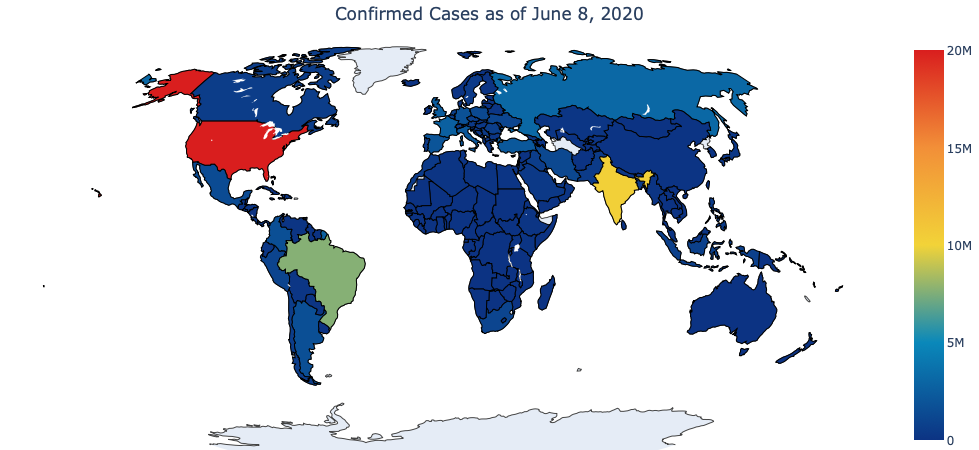

In [10]:
trace=go.Choropleth(locations=df_countries['Country'],
                   locationmode='country names',
                   z=df_countries['Confirmed'],
                   colorscale='Portland',
                   marker_line_color='black',
                    marker_line_width=1)
data=[trace]
fig=go.Figure(data=data)

fig.update_layout(
    title_text = 'Confirmed Cases as of June 8, 2020',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = True,
        projection_type = 'robinson'
    )
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

## Animated Choropleth Map

In [11]:
df_countrydate= df_world[df_world['Confirmed']>0]
df_countrydate= df_countrydate.groupby(['Date','Country']).sum().reset_index()
df_countrydate.head()

,Date,Country,SNo,Confirmed,Deaths,Recovered
0,01/01/2021,Afghanistan,191495,51526.0,2191.0,41727.0
1,01/01/2021,Albania,191496,58316.0,1181.0,33634.0
2,01/01/2021,Algeria,191497,99897.0,2762.0,67395.0
3,01/01/2021,Andorra,191498,8117.0,84.0,7463.0
4,01/01/2021,Angola,191499,17568.0,405.0,11146.0


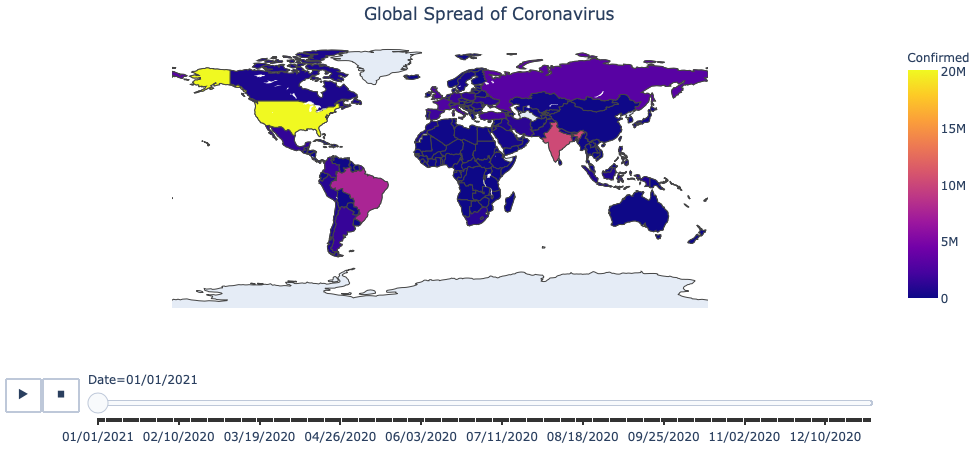

In [13]:
fig = px.choropleth(df_countrydate,
                    locations="Country", 
                    locationmode = "country names",
                    color="Confirmed",
                    hover_name="Country", 
                    animation_frame="Date"
                   )
fig.update_layout(
    title_text = 'Global Spread of Coronavirus',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = True,
    ))

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
    
iplot(fig)

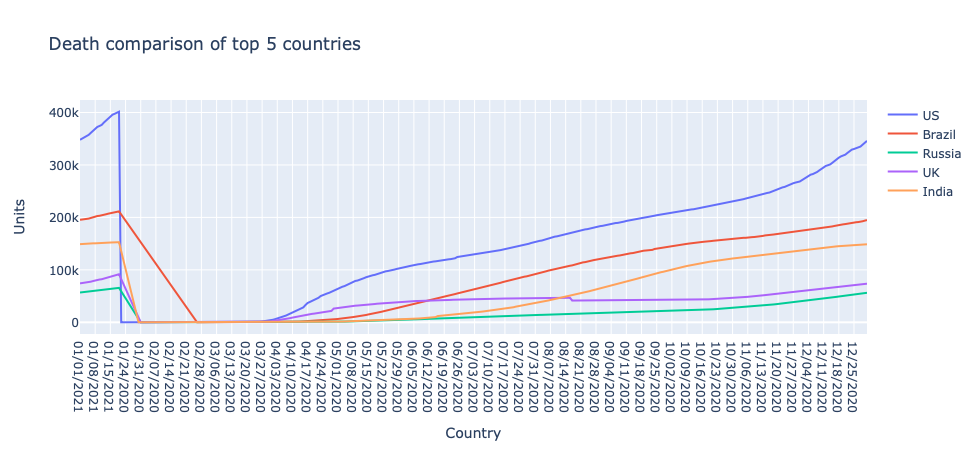

In [15]:
df_us=df_countrydate[df_countrydate['Country']=='US']
trace1=go.Scatter(x=df_us.Date,
                 y=df_us['Deaths'],
                mode='lines',
                 name='US')

df_spain=df_countrydate[df_countrydate['Country']=='Brazil']
trace2=go.Scatter(x=df_spain.Date,
                 y=df_spain['Deaths'],
                 mode='lines',
                 name='Brazil')

df_italy=df_countrydate[df_countrydate['Country']=='Russia']
trace3=go.Scatter(x=df_italy.Date,
                 y=df_italy['Deaths'],
                 mode='lines',
                 name='Russia')

df_uk=df_countrydate[df_countrydate['Country']=='UK']
trace4=go.Scatter(x=df_uk.Date,
                 y=df_uk['Deaths'],
                 mode='lines',
                 name='UK')

df_france=df_countrydate[df_countrydate['Country']=='India']
trace5=go.Scatter(x=df_france.Date,
                 y=df_france['Deaths'],
                 mode='lines',
                 name='India')


data=[trace1,trace2,trace3,trace4,trace5]

layout={'title':'Death comparison of top 5 countries',
       'xaxis':{'title':'Country'},
       'yaxis':{'title':'Units'}}

fig=go.Figure(data=data, layout=layout)

iplot(fig)

## New World Dataset

In [16]:
df=pd.read_csv('Datasets/covid_world.csv')
df.head()
df=df.drop(['FIPS','Admin2','Last_Update','Lat','Long_','Combined_Key'],axis=1)
df=df.rename(columns={'Country_Region':'Country'})
df=df.rename(columns={'Province_State':'State'})
df_top=df.groupby('Country').sum().sort_values('Confirmed',ascending=False).reset_index()
df_top

,Country,Confirmed,Deaths,Recovered,Active,Incident_Rate,Case_Fatality_Ratio
0,US,26813772,459555,0,26354025.0,2.671724e+07,8109.011018
1,India,10814304,154918,10510796,148590.0,4.001190e+04,43.451144
2,Brazil,9447165,230034,8396148,820983.0,1.524705e+05,59.771430
3,United Kingdom,3922910,111477,10094,3801382.0,4.453287e+04,31.846773
4,Russia,3891274,74520,3375999,440755.0,2.282719e+05,144.374664
...,...,...,...,...,...,...,...
187,MS Zaandam,9,2,7,0.0,0.000000e+00,22.222222
188,Marshall Islands,4,0,4,0.0,6.847791e+00,0.000000
189,Samoa,2,0,2,0.0,1.019732e+00,0.000000
190,Vanuatu,1,0,1,0.0,3.416701e-01,0.000000


In [17]:
df_top10=df_top.head(10)

## Top 10 Countries

### Deaths vs Recoveries

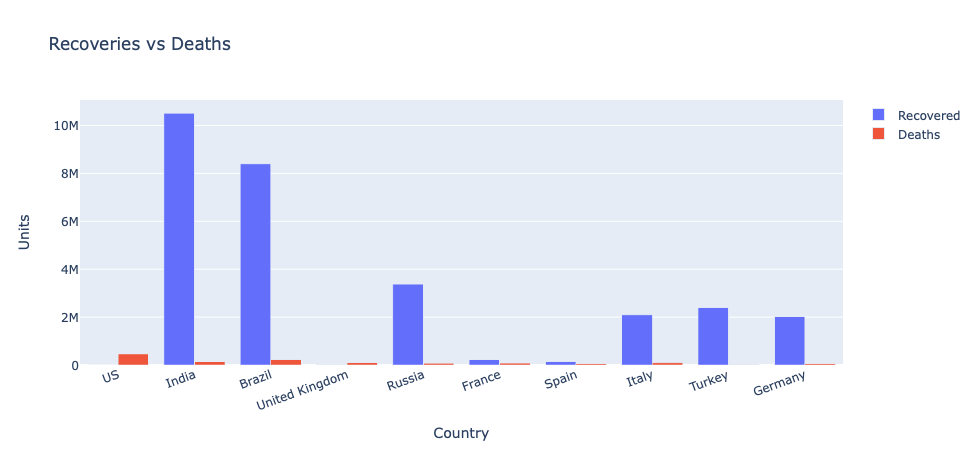

In [18]:
trace1=go.Bar(x=df_top10.Country,
            y=df_top10.Recovered,
             name='Recovered')

trace2=go.Bar(x=df_top10.Country,
              y=df_top10.Deaths,
              name="Deaths")

data=[trace1,trace2]

layout={'title':'Recoveries vs Deaths',
       'xaxis':{'title':'Country', 'tickangle':-20},
       'yaxis':{'title':'Units'},
       'barmode':'group'}

iplot({'data':data, 'layout':layout})

### Confirmed Cases

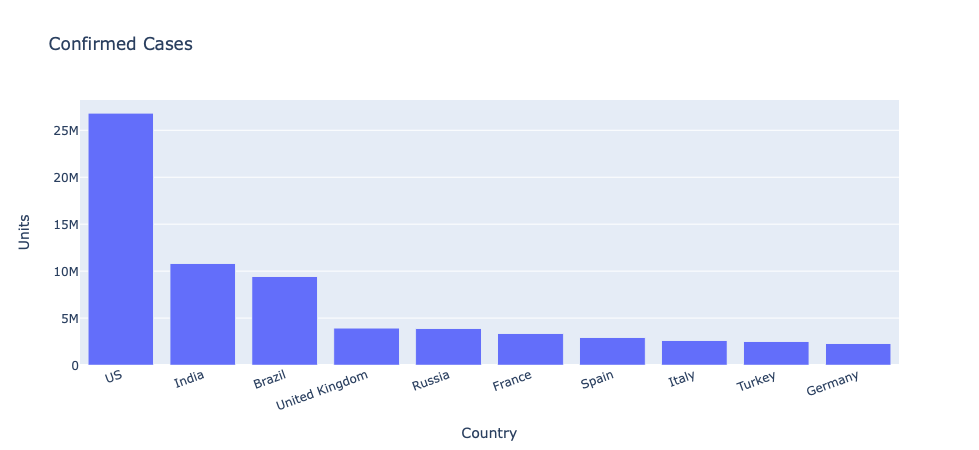

In [19]:
trace=go.Bar(x=df_top10.Country,
            y=df_top10.Confirmed)

data=[trace]
layout={'title':'Confirmed Cases',
       'xaxis':{'title':'Country', 'tickangle':-20},
       'yaxis':{'title':'Units'}}

iplot({'data':data,'layout':layout})


## Proportion of confirmed Cases by Country

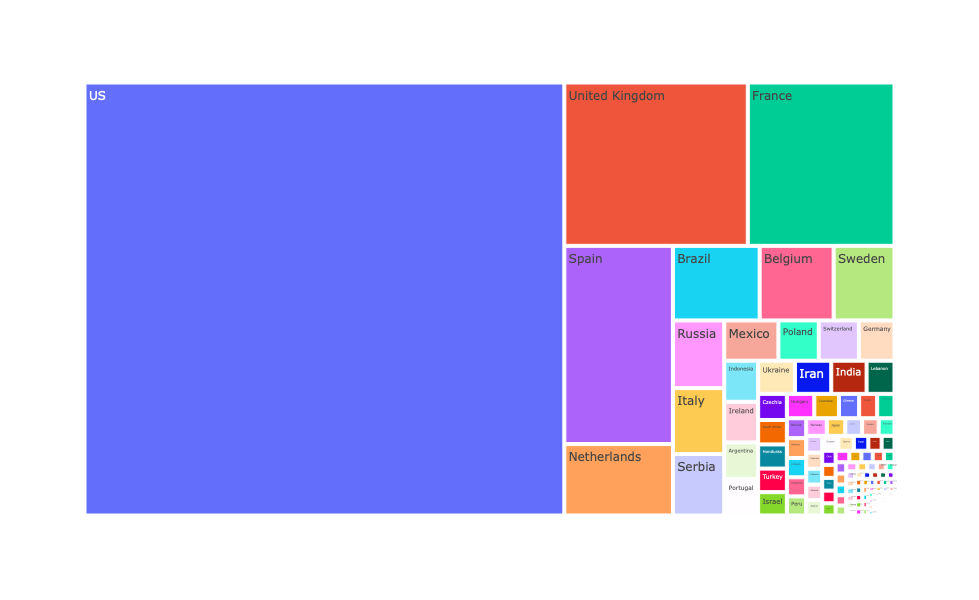

In [21]:
fig = px.treemap(df_top, path=['Country'], values='Active', height=600, width=1000)

fig.update_layout(
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = False,
    ))

fig.show()

# India

In [23]:
url='https://api.covid19india.org/csv/latest/case_time_series.csv'
context = ssl._create_unverified_context()
data=urllib.request.urlopen(url, context=context)

In [24]:
df_india=pd.read_csv(data)

In [25]:
df_india.head()

,Date,Date_YMD,Daily Confirmed,Total Confirmed,Daily Recovered,Total Recovered,Daily Deceased,Total Deceased
0,30 January,2020-01-30,1,1,0,0,0,0
1,31 January,2020-01-31,0,1,0,0,0,0
2,01 February,2020-02-01,0,1,0,0,0,0
3,02 February,2020-02-02,1,2,0,0,0,0
4,03 February,2020-02-03,1,3,0,0,0,0


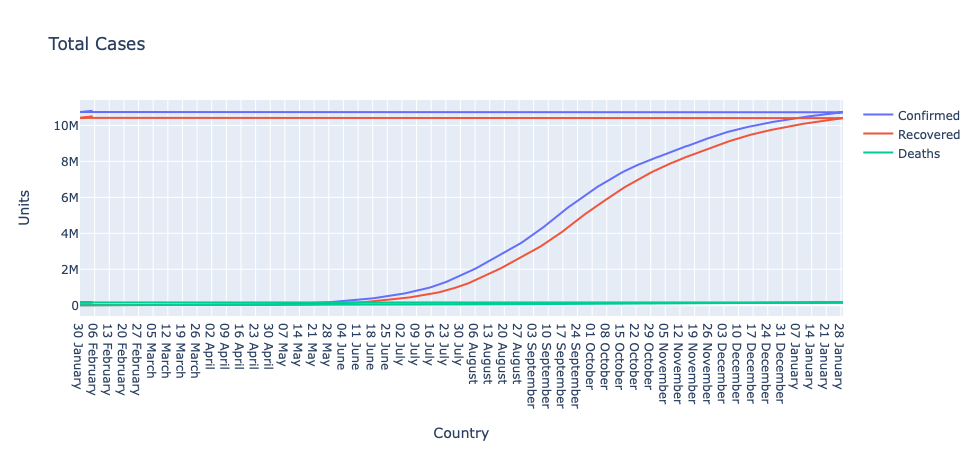

In [26]:
trace1=go.Scatter(x=df_india.Date,
                 y=df_india['Total Confirmed'],
                mode='lines',
                 name='Confirmed')

trace2=go.Scatter(x=df_india.Date,
                 y=df_india['Total Recovered'],
                mode='lines',
                 name='Recovered')

trace3=go.Scatter(x=df_india.Date,
                 y=df_india['Total Deceased'],
                mode='lines',
                 name='Deaths')


data=[trace1,trace2,trace3]

layout={'title':'Total Cases',
       'xaxis':{'title':'Country'},
       'yaxis':{'title':'Units'}}

fig=go.Figure(data=data, layout=layout)

iplot(fig)

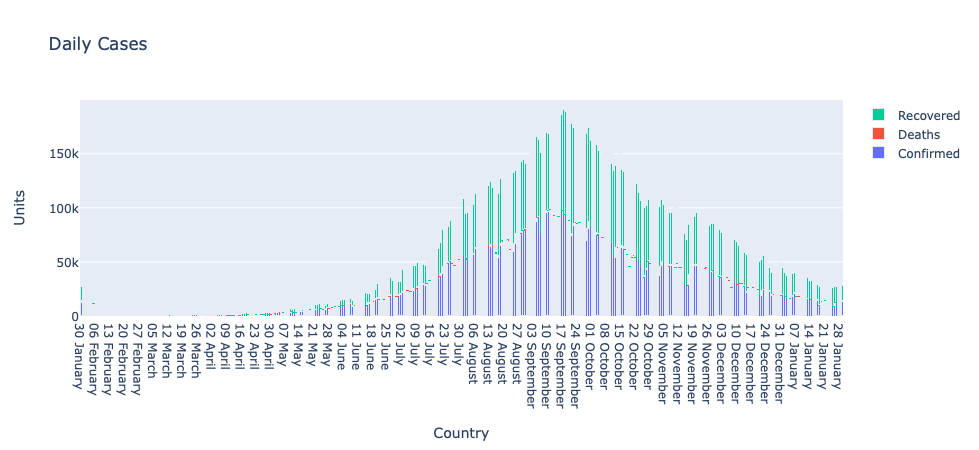

In [27]:
trace1=go.Bar(x=df_india.Date,
            y=df_india['Daily Confirmed'],
             name='Confirmed')

trace2=go.Bar(x=df_india.Date,
            y=df_india['Daily Deceased'],
             name='Deaths')

trace3=go.Bar(x=df_india.Date,
            y=df_india['Daily Recovered'],
             name='Recovered')

data=[trace1,trace2,trace3]
layout={'title':'Daily Cases',
       'xaxis':{'title':'Country'},
       'yaxis':{'title':'Units'},
       'barmode':'stack'}

iplot({'data':data,'layout':layout})

In [28]:
url='https://api.covid19india.org/csv/latest/raw_data3.csv'
context = ssl._create_unverified_context()
data=urllib.request.urlopen(url, context=context)
df_gender_age=pd.read_csv(data)
df_gender_age

,Entry_ID,State Patient Number,Date Announced,Age Bracket,Gender,Detected City,Detected District,Detected State,State code,Num Cases,Current Status,Contracted from which Patient (Suspected),Notes,Source_1,Source_2,Source_3,Nationality,Type of transmission,Status Change Date,Patient Number
0,1,NaN,27/04/2020,NaN,NaN,NaN,NaN,West Bengal,WB,38.0,Hospitalized,NaN,Details awaited,mohfw.gov.in,NaN,NaN,NaN,NaN,NaN,27892.0
1,2,NaN,27/04/2020,NaN,NaN,NaN,Bhilwara,Rajasthan,RJ,2.0,Hospitalized,NaN,Details awaited,https://twitter.com/ANI/status/125461859651442...,NaN,NaN,NaN,NaN,NaN,27893.0
2,3,NaN,27/04/2020,NaN,NaN,NaN,Jaipur,Rajasthan,RJ,9.0,Hospitalized,NaN,Details awaited,https://twitter.com/ANI/status/125461859651442...,NaN,NaN,NaN,NaN,NaN,27894.0
3,4,NaN,27/04/2020,28.0,M,Surajpol,Jaipur,Rajasthan,RJ,1.0,Deceased,NaN,Details awaited,https://twitter.com/ANI/status/125461859651442...,NaN,NaN,NaN,NaN,NaN,27895.0
4,5,NaN,27/04/2020,NaN,NaN,NaN,Jaisalmer,Rajasthan,RJ,1.0,Hospitalized,NaN,Details awaited,https://twitter.com/ANI/status/125461859651442...,NaN,NaN,NaN,NaN,NaN,27896.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10015,43270,NaN,27/04/2020,NaN,NaN,NaN,Thoothukkudi,Tamil Nadu,TN,-1.0,Deceased,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10016,43271,NaN,27/04/2020,NaN,NaN,NaN,NaN,Tamil Nadu,TN,1.0,Deceased,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10017,43272,NaN,14/03/2020,NaN,NaN,NaN,NaN,Himachal Pradesh,HP,1.0,Migrated_Other,NaN,Entry for reduction from Active,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10018,43273,NaN,14/03/2020,NaN,NaN,NaN,NaN,Himachal Pradesh,HP,1.0,Migrated_Other,NaN,Entry for reduction from Active,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [29]:
df_gender_age=df_gender_age.drop(['State Patient Number','Notes','Nationality','Type of transmission','Status Change Date','Source_1','Source_2','Source_3'],axis=1)

In [30]:
df_gender_age=df_gender_age[df_gender_age['Gender']!='Non-Binary']

In [31]:
df_gender=df_gender_age.groupby('Gender').count()
df_gender['Count']=df_gender['Patient Number']

df_gender

,Entry_ID,Date Announced,Age Bracket,Detected City,Detected District,Detected State,State code,Num Cases,Current Status,Contracted from which Patient (Suspected),Patient Number,Count
Gender,,,,,,,,,,,,
F,1481,1481,1477,145,1481,1481,1481,1481,1481,121,1481,1481
M,3171,3171,3167,233,3170,3171,3171,3171,3171,119,3171,3171


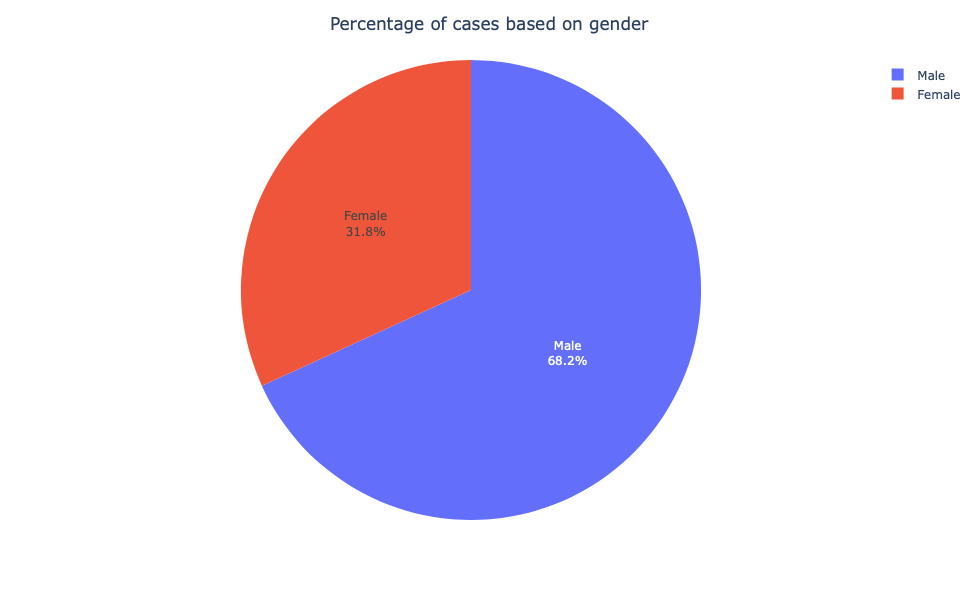

In [32]:
fig = px.pie(df_gender, values = 'Count',names=['Female','Male'],height=600)
fig.update_traces(textposition='inside', textinfo='percent+label')

fig.update_layout(
    title='Percentage of cases based on gender',
    title_x = 0.5)

iplot(fig)

In [33]:
df_age=df_gender_age.groupby('Age Bracket').count()
df_age

,Entry_ID,Date Announced,Gender,Detected City,Detected District,Detected State,State code,Num Cases,Current Status,Contracted from which Patient (Suspected),Patient Number
Age Bracket,,,,,,,,,,,
1.0,36,36,31,6,36,36,36,36,36,2,36
1.5,1,1,1,0,1,1,1,1,1,0,1
2.0,26,26,26,9,26,26,26,26,26,1,26
2.5,1,1,1,0,1,1,1,1,1,0,1
3.0,26,26,23,5,26,26,26,26,26,3,26
...,...,...,...,...,...,...,...,...,...,...,...
85.0,4,4,3,1,4,4,4,4,4,0,4
87.0,1,1,1,0,1,1,1,1,1,0,1
88.0,1,1,1,0,1,1,1,1,1,0,1


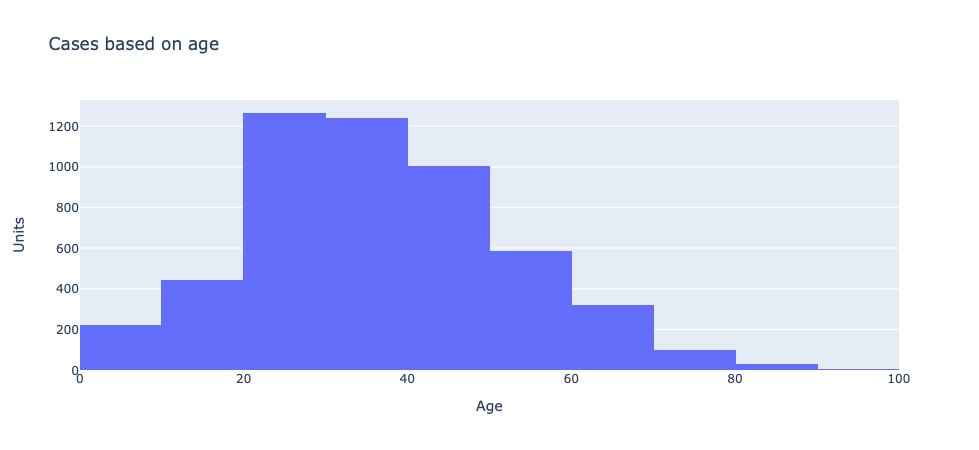

In [34]:
trace=go.Histogram(x=df_gender_age['Age Bracket'],
                   xbins=dict(start=0, end=100, size=10))
                   

data=[trace]

layout={'title':'Cases based on age',
       'xaxis':{'title':'Age'},
       'yaxis':{'title':'Units'}}

iplot({'data':data, 'layout':layout})

## India State Analysis

In [35]:
url='https://api.covid19india.org/csv/latest/state_wise.csv'
context = ssl._create_unverified_context()
data=urllib.request.urlopen(url, context=context)
df_states=pd.read_csv(data)
df_states.head()

,State,Confirmed,Recovered,Deaths,Active,Last_Updated_Time,Migrated_Other,State_code,Delta_Confirmed,Delta_Recovered,Delta_Deaths,State_Notes
0,Total,10817478,10512178,154975,145801,6/2/2021 20:59:15,4524,TT,2232,2365,18,NaN
1,Maharashtra,2038630,1952187,51255,33936,05/02/2021 22:02:17,1252,MH,0,0,0,"[Dec 16]:10,218 duplicate cases & other state ..."
2,Karnataka,942031,923811,12233,5968,06/02/2021 20:59:16,19,KA,531,434,3,NaN
3,Andhra Pradesh,888350,880179,7159,1012,06/02/2021 17:11:15,0,AP,75,133,1,NaN
4,Tamil Nadu,841326,824527,12382,4417,06/02/2021 20:59:17,0,TN,477,503,3,[July 22]: 444 backdated deceased entries adde...


In [36]:
df_states=df_states.drop(['Delta_Confirmed','Delta_Recovered', 'Delta_Deaths','State_Notes'], axis=1)

In [37]:
df_states=df_states[df_states['State']!='Total']

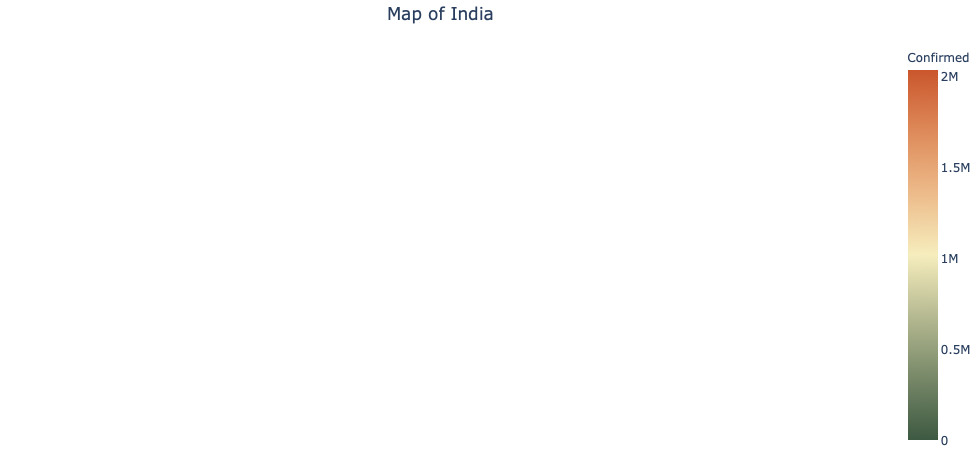

In [38]:
# from urllib.request import urlopen
# import json
# context = ssl._create_unverified_context()
# with urlopen('https://raw.githubusercontent.com/Subhash9325/GeoJson-Data-of-Indian-States/master/Indian_States',context=context) as response:
#     india= json.load(response)

# india['features'][1]


with open('Json/india-2.json') as file:
    india=json.load(file)
    

fig = px.choropleth_mapbox(df_states, geojson=india, color="Confirmed",
                           locations="State", featureidkey="properties.st_nm",
                           center={"lat": 22.9734, "lon": 78.962},
                           color_continuous_scale='fall', #aggrnyl,sunsetdark,agsunset,armyrose,fall
                           mapbox_style="white-bg", zoom=3)
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0},
                 title='Map of India',
                 title_x=0.45)
fig.update_geos(fitbounds="locations", visible=False)
iplot(fig)


# fig = go.Figure(go.Choroplethmapbox(geojson=india,locations=df_states.State,z=df_states.Confirmed,
#                                     colorscale='Cividis',
#                                     featureidkey="properties.NAME_1",
#                                     marker_opacity=0.5, marker_line_width=0))
# fig.update_layout(mapbox_style="carto-positron",
#                   mapbox_zoom=3, mapbox_center = {"lat": 20.5937, "lon": 78.9629})

# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()

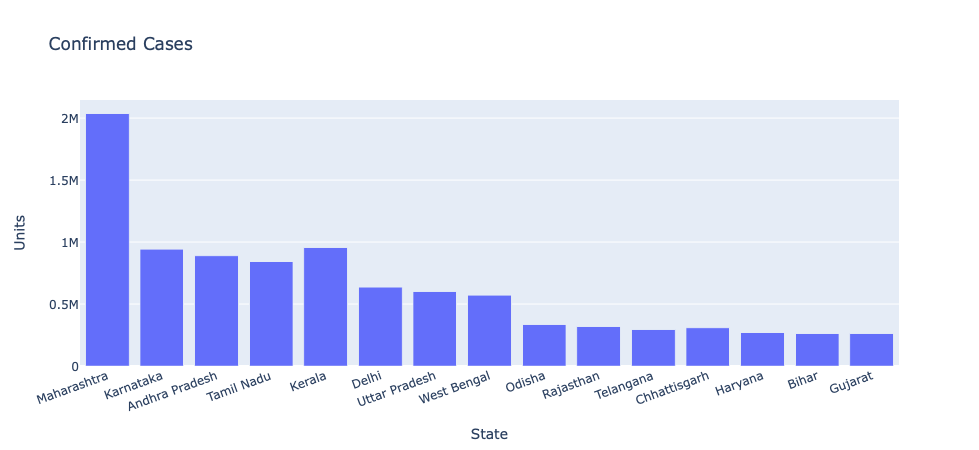

In [39]:
df_states15=df_states[df_states['Confirmed']>0].head(15)
trace=go.Bar(x=df_states15.State,
            y=df_states15.Confirmed)

data=[trace]
layout={'title':'Confirmed Cases',
       'xaxis':{'title':'State', 'tickangle':-20},
       'yaxis':{'title':'Units'}}

iplot({'data':data,'layout':layout})

## India Districts analysis

In [40]:
url='https://api.covid19india.org/csv/latest/district_wise.csv'
context = ssl._create_unverified_context()
data=urllib.request.urlopen(url, context=context)
df_city=pd.read_csv(data)
df_city

,SlNo,State_Code,State,District_Key,District,Confirmed,Active,Recovered,Deceased,Migrated_Other,Delta_Confirmed,Delta_Active,Delta_Recovered,Delta_Deceased,District_Notes,Last_Updated
0,0,UN,State Unassigned,UN_Unassigned,Unassigned,0,0,0,0,0,0,0,0,0,NaN,NaN
1,1,AN,Andaman and Nicobar Islands,AN_Nicobars,Nicobars,0,0,0,0,0,0,0,0,0,District-wise numbers are out-dated as cumulat...,NaN
2,2,AN,Andaman and Nicobar Islands,AN_North and Middle Andaman,North and Middle Andaman,1,0,1,0,0,0,0,0,0,District-wise numbers are out-dated as cumulat...,NaN
3,3,AN,Andaman and Nicobar Islands,AN_South Andaman,South Andaman,51,19,32,0,0,0,0,0,0,District-wise numbers are out-dated as cumulat...,NaN
4,0,AP,Andhra Pradesh,AP_Foreign Evacuees,Foreign Evacuees,434,0,434,0,0,0,0,0,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
796,760,TG,Telangana,TG_Unknown,Unknown,496,-292377,291295,1578,0,0,0,0,0,NaN,NaN
797,761,TR,Tripura,TR_Unknown,Unknown,0,0,0,0,0,0,0,0,0,NaN,NaN
798,762,UP,Uttar Pradesh,UP_Unknown,Unknown,0,0,0,0,0,0,0,0,0,NaN,NaN
799,763,UT,Uttarakhand,UT_Unknown,Unknown,0,0,0,0,0,0,0,0,0,NaN,NaN


In [41]:
df_district=df_city.drop(['SlNo','District_Key','Delta_Confirmed','Delta_Recovered','Delta_Active','Delta_Deceased','District_Notes'],axis=1)

In [42]:
df_district.head()

,State_Code,State,District,Confirmed,Active,Recovered,Deceased,Migrated_Other,Last_Updated
0,UN,State Unassigned,Unassigned,0,0,0,0,0,NaN
1,AN,Andaman and Nicobar Islands,Nicobars,0,0,0,0,0,NaN
2,AN,Andaman and Nicobar Islands,North and Middle Andaman,1,0,1,0,0,NaN
3,AN,Andaman and Nicobar Islands,South Andaman,51,19,32,0,0,NaN
4,AP,Andhra Pradesh,Foreign Evacuees,434,0,434,0,0,NaN


In [43]:
df_cities=df_district.groupby('District').sum().sort_values('Confirmed',ascending=False).reset_index()
df_cities=df_cities[df_cities['District']!='Unknown']
df_cities

,District,Confirmed,Active,Recovered,Deceased,Migrated_Other,Last_Updated
1,Bengaluru Urban,400315,3937,391975,4402,1,0.0
2,Pune,390574,5222,377312,7998,42,0.0
3,Mumbai,311019,5750,292968,11384,917,0.0
4,Thane,270113,6499,257776,5777,61,0.0
5,Chennai,232168,1570,226487,4111,0,0.0
...,...,...,...,...,...,...,...
739,Nicobars,0,0,0,0,0,0.0
740,Mumbai Suburban,0,0,0,0,0,0.0
741,Mirpur,0,0,0,0,0,0.0
742,Unassigned,0,0,0,0,0,0.0


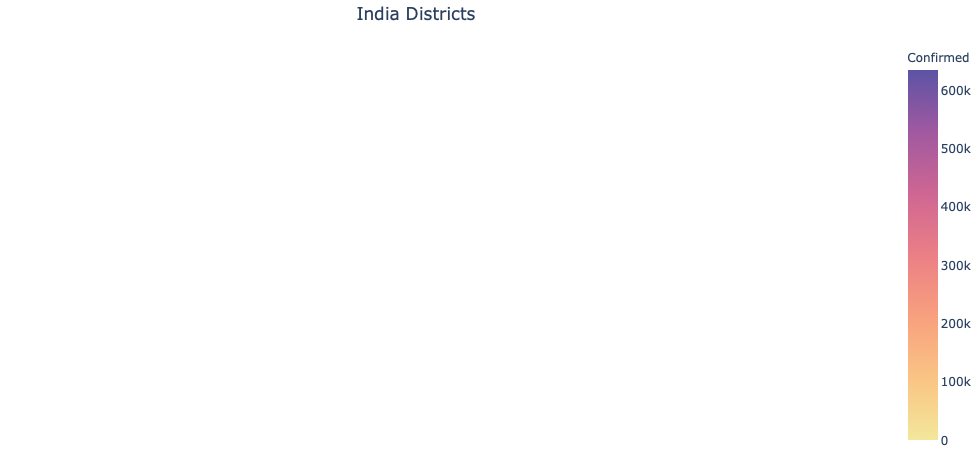

In [44]:
with open('Json/india_district.json') as file:
    district=json.load(file)
    

fig = px.choropleth_mapbox(df_district, geojson=district, color="Confirmed",
                           locations="District", featureidkey="properties.district",
                           color_continuous_scale='sunset',
                           center={"lat": 22.9734, "lon": 78.962},
                           mapbox_style="white-bg", zoom=3)
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0},
                 title='India Districts',
                 title_x=0.425)
fig.update_geos(fitbounds="locations", visible=False)
iplot(fig)

In [45]:
df_city10=df_cities[df_cities['District']!='Unknown']
df_city10=df_city10[df_city10['Confirmed']>0].head(10)
df_city10

,District,Confirmed,Active,Recovered,Deceased,Migrated_Other,Last_Updated
1,Bengaluru Urban,400315,3937,391975,4402,1,0.0
2,Pune,390574,5222,377312,7998,42,0.0
3,Mumbai,311019,5750,292968,11384,917,0.0
4,Thane,270113,6499,257776,5777,61,0.0
5,Chennai,232168,1570,226487,4111,0,0.0
6,Nagpur,137035,3323,130298,3373,41,0.0
7,Kolkata,128089,1162,123847,3080,0,0.0
8,East Godavari,124314,104,123574,636,0,0.0
9,Nashik,122088,1136,118951,2000,1,0.0
10,North 24 Parganas,122030,1169,118375,2486,0,0.0


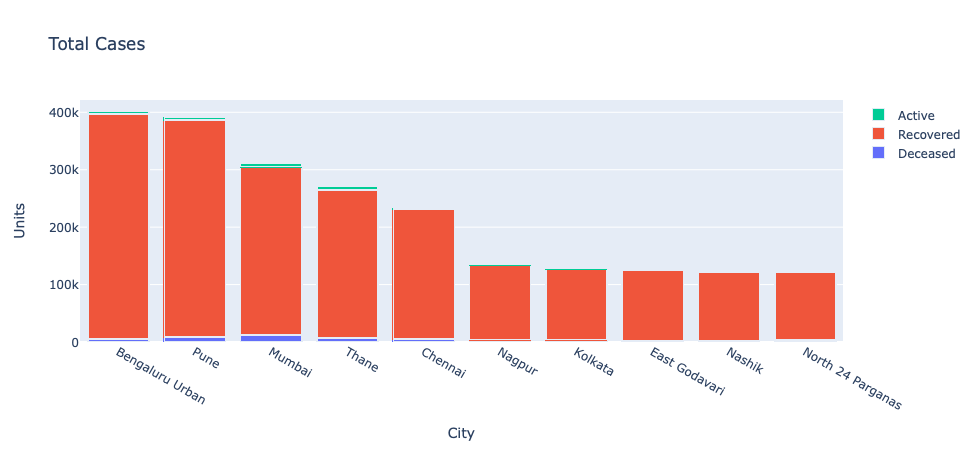

In [46]:
trace1=go.Bar(x=df_city10.District,
                 y=df_city10['Deceased'],
                 name='Deceased')

trace2=go.Bar(x=df_city10.District,
                 y=df_city10['Recovered'],
                 name='Recovered')
trace3=go.Bar(x=df_city10.District,
                 y=df_city10['Active'],
                 name='Active')


data=[trace1,trace2,trace3]

layout={'title':'Total Cases',
       'xaxis':{'title':'City'},
       'yaxis':{'title':'Units'},
       'barmode':'stack'}

fig=go.Figure(data=data,layout=layout)

iplot(fig)

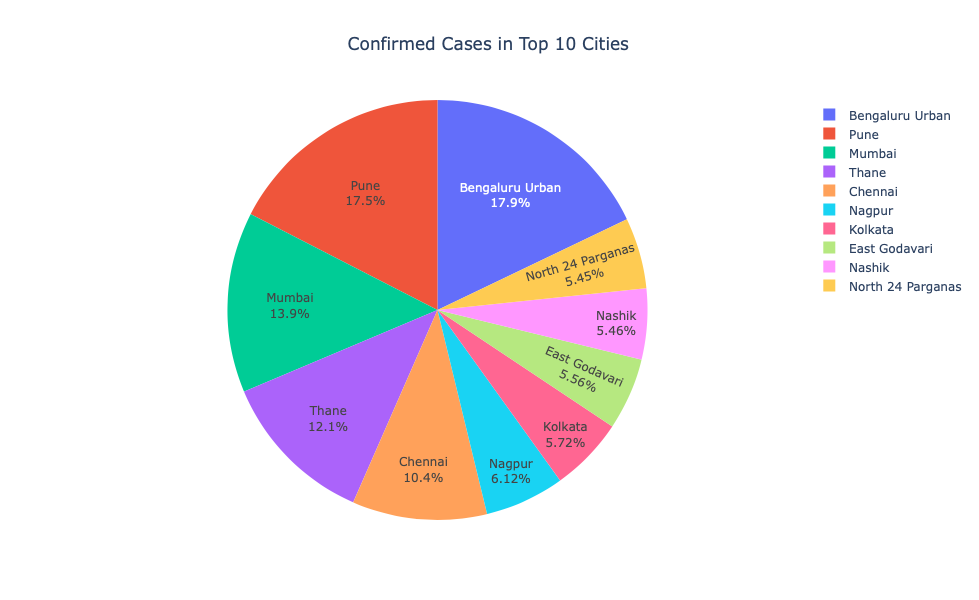

In [47]:
fig = px.pie(df_city10, values = 'Confirmed',names='District', height=600,title='Confirmed Cases in Top 10 Cities ')
fig.update_traces(textposition='inside', textinfo='percent+label')

fig.update_layout(
    title_x = 0.5,)

fig.show()

## Uttar Pradesh Coronavirus Analysis

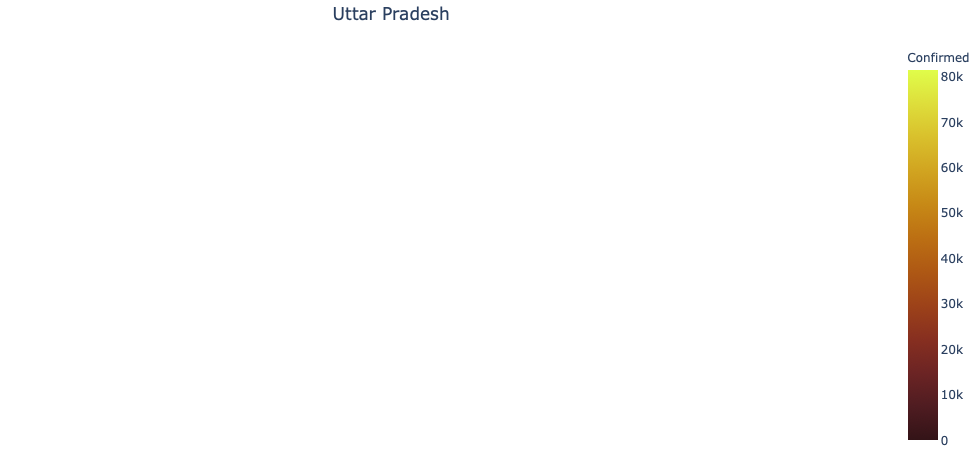

In [48]:
df_upd=df_district[df_district['State']=='Uttar Pradesh']

with open('Json/up_district.json') as file:
    mh=json.load(file)

fig = px.choropleth_mapbox(df_upd, geojson=mh, color="Confirmed",
                           locations="District", featureidkey="properties.district",
                           center={"lat": 26.8467, "lon":80.9462},
                           color_continuous_scale='solar',
                           mapbox_style="white-bg", zoom=5)
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0},
                 title='Uttar Pradesh',
                 title_x=0.4)
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

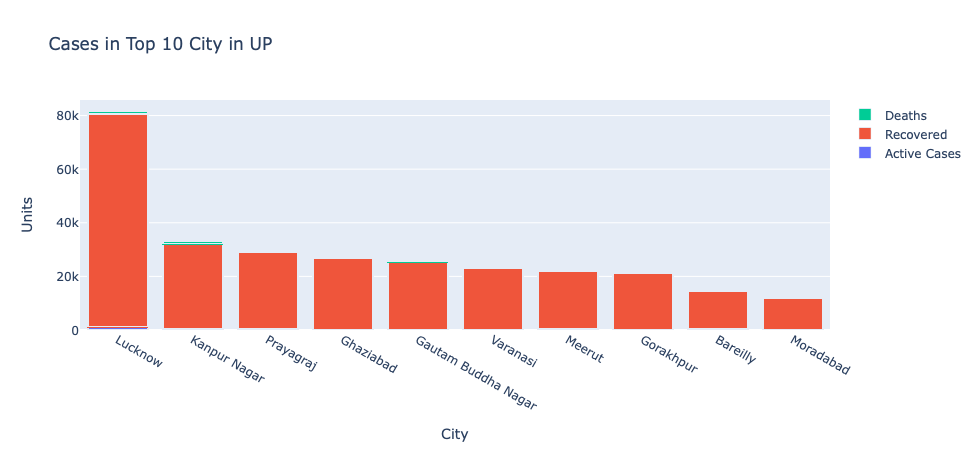

In [49]:
df_up=df_upd.sort_values('Confirmed', ascending=False)
df_up10=df_up.head(10)
df_up10

trace1=go.Bar(x=df_up10.District,
                 y=df_up10['Deceased'],
                 name='Deaths')

trace2=go.Bar(x=df_up10.District,
                 y=df_up10['Recovered'],
                 name='Recovered')
trace3=go.Bar(x=df_up10.District,
                 y=df_up10['Active'],
                 name='Active Cases')


data=[trace3,trace2,trace1]

layout={'title':'Cases in Top 10 City in UP',
       'xaxis':{'title':'City'},
       'yaxis':{'title':'Units'},
       'barmode':'stack'}

fig=go.Figure(data=data,layout=layout)

iplot(fig)

## Maharshtra Coronavirus Analysis

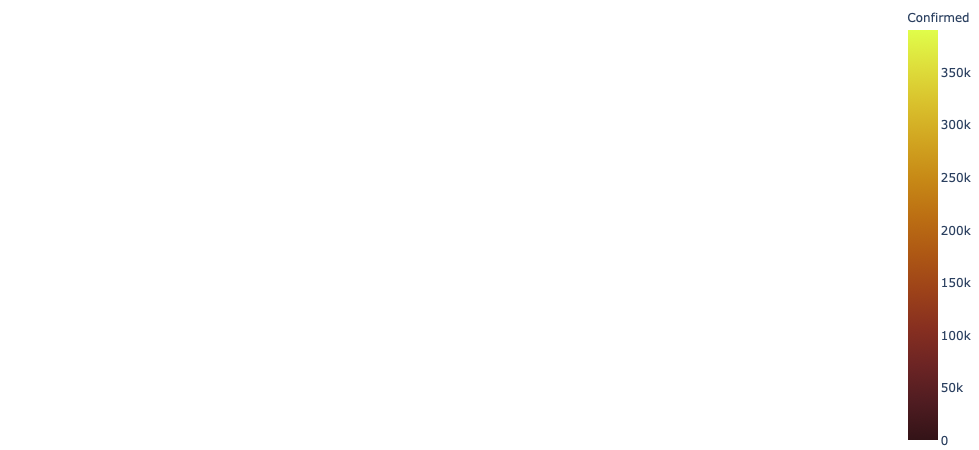

In [50]:
df_mhd=df_district[df_district['State']=='Maharashtra']

with open('Json/maharashtra_district.json') as file:
    mh=json.load(file)

fig = px.choropleth_mapbox(df_mhd, geojson=mh, color="Confirmed",
                           locations="District", featureidkey="properties.district",
                           center={"lat": 19.7515, "lon": 75.7139},
                           color_continuous_scale='solar',
                           mapbox_style="white-bg", zoom=5)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

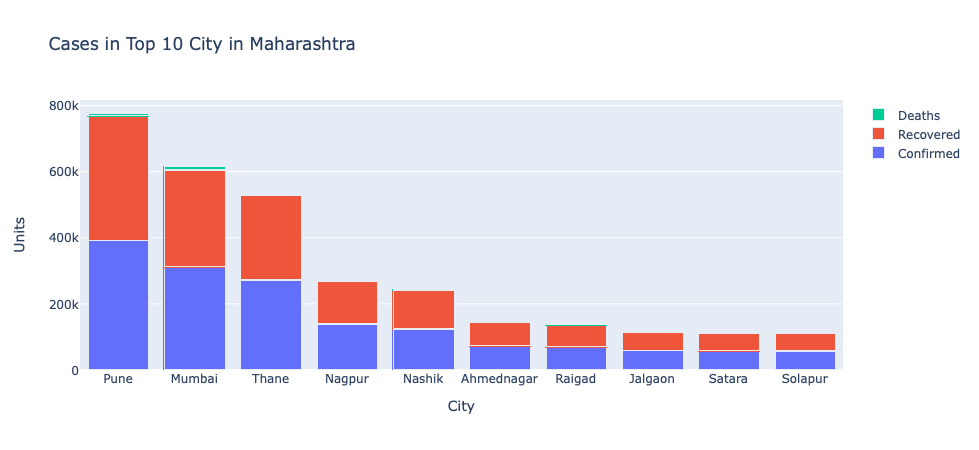

In [51]:
df_mh=df_mhd.sort_values('Confirmed', ascending=False)
df_mh10=df_mh.head(10)

trace1=go.Bar(x=df_mh10.District,
                 y=df_mh10['Deceased'],
                 name='Deaths')

trace2=go.Bar(x=df_mh10.District,
                 y=df_mh10['Recovered'],
                 name='Recovered')
trace3=go.Bar(x=df_mh10.District,
                 y=df_mh10['Confirmed'],
                 name='Confirmed')


data=[trace3,trace2,trace1]

layout={'title':'Cases in Top 10 City in Maharashtra',
       'xaxis':{'title':'City'},
       'yaxis':{'title':'Units'},
       'barmode':'stack'}

fig=go.Figure(data=data,layout=layout)

iplot(fig)

## Zone distribution

In [52]:
df_zone=pd.read_csv('Datasets/zone.csv')
df_zone=df_zone.drop(['districtcode','lastupdated','source','statecode'],axis=1)
df_zone.head()

,district,state,zone
0,Nicobars,Andaman and Nicobar Islands,Green
1,North and Middle Andaman,Andaman and Nicobar Islands,Green
2,South Andaman,Andaman and Nicobar Islands,Red
3,Anantapur,Andhra Pradesh,Orange
4,Chittoor,Andhra Pradesh,Red


In [53]:
df_zone1=df_zone.dropna()
df_zone1.head()

,district,state,zone
0,Nicobars,Andaman and Nicobar Islands,Green
1,North and Middle Andaman,Andaman and Nicobar Islands,Green
2,South Andaman,Andaman and Nicobar Islands,Red
3,Anantapur,Andhra Pradesh,Orange
4,Chittoor,Andhra Pradesh,Red


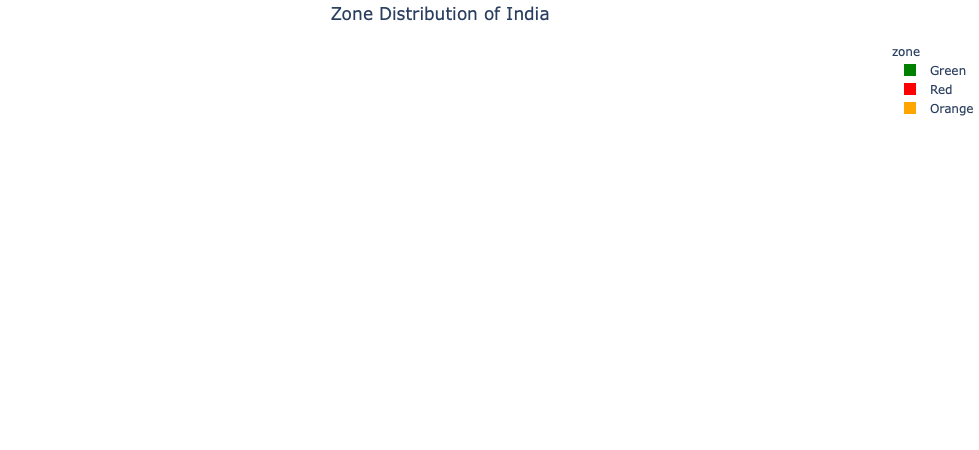

In [54]:
with open('Json/india_district.json') as file:
    district=json.load(file)
    

fig = px.choropleth_mapbox(df_zone1, geojson=district, color="zone",
                           locations="district", featureidkey="properties.district",
                           color_discrete_map={"Green":"green", 'Red':'red', "Orange":'orange'},
                           center={"lat": 22.9734, "lon": 78.962},
                           mapbox_style="white-bg", zoom=3)
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0},
                 title='Zone Distribution of India',
                 title_x=0.45)
fig.update_geos(fitbounds="locations", visible=False)
iplot(fig)